<a href="https://colab.research.google.com/github/JapiKredi/Stable_Diffusion_text_to_image_prompting/blob/main/Stable_Diffusion_PixxelCraftAI_S2_B.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Stable Diffusion Setup
In this section, we will setup the environment so that we are able to work with the Stable Diffusion model.

Make sure that you are connected to a **T4 GPU** on colab. You can connect to a GPU using the menu as follows:

> Runtime > Change runtime type > Hardware Accelerator: GPU

By default, Colab will connect you to an NVIDIA Tesla-4 GPU.

In [1]:
# Check the status of the GPU in this Colab environment
!nvidia-smi

Thu Mar 28 06:03:00 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

We will start by installing some dependencies for running Stable Diffusion in this Colab environment. The following packages help optimise the execution of Stable Diffusion models.

In [2]:
!pip install -qU diffusers==0.11.1
!pip install -qU transformers scipy ftfy accelerate
!pip install -qU invisible_watermark safetensors
!pip install --upgrade torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.4/38.4 MB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 290.1/290.1 kB 24.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 40.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 55.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 46.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 745.0 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━ 356.7/410.6 MB 928.7 kB/s eta 0:00:58
ERROR: THESE PACKAGES DO NOT MATCH THE HASHES FROM THE REQUIREMENTS FILE. If you have updated the package versions, please update the hashes. Otherwise, examine the package contents 

Note that Stable Diffusion is an open-source model and there are many implementations based on the type of diffusers used to train the model. Some of the popular implementations that are available are:
- `runwayml/stable-diffusion-v1-5`
- `stabilityai/stable-diffusion-2-1-base`
- `stabilityai/stable-diffusion-2-1`
<br><br>

For this demonstration, we will use SD 2.1, which was trained on 768x768 images, and is generally better than SD 1.5, which was trained on 512x512 images.

You can read more about this model on their official [release blog post](https://stability.ai/blog/stablediffusion2-1-release7-dec-2022) or check out their [model card on HF](https://huggingface.co/stabilityai/stable-diffusion-2-1).
<br><br>

We will next import the Stable Diffusion pipeline that allows us to put all these pieces together, that is the model, the diffuser, the GPU, and other components.

For the purposes of this demonstration, we are downloading StableDiffusion provided by StabilityAI on Hugging Face Hub.

In [3]:
# Import the Stable Diffusion pipeline method and set up the pipeline
# Note: You can change the model here if you want
import torch
from diffusers import StableDiffusionPipeline

model_name = 'stabilityai/stable-diffusion-2-1'
pipe = StableDiffusionPipeline.from_pretrained(model_name,
                                               torch_dtype = torch.float16)

# Convert the pipe to the CUDA language that is used by NVIDIA GPUs
pipe = pipe.to('cuda')

model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

text_encoder/pytorch_model.fp16.safetensors not found


Fetching 22 files:   0%|          | 0/22 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/939 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/681M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

pytorch_model.fp16.bin:   0%|          | 0.00/681M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.73G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.bin:   0%|          | 0.00/1.73G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.bin:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


We will now define a function that specifies relevant parameters associated with the SD 2.1 model that control the nature of the operations being performed including parameters such as the size of the output image, the number of images to output, and so on.
<br><br>

Here is a description of each parameter:
- *prompt*: This is the text input that is used to generate a new image
- *negative_prompt*: This is the text input that is used to suppress parts of the output image
- *num_inference_steps*: This is the number of inference steps that SD executes before returning an output image
- *guidance_scale*: This is a value that controls how closely generated images follow the input prompts
- *height*: This is the height of the output image in number of pixels
- *width*: This is the width of the output image in number of pixels
- *num_images_per_prompt*: This is the number of images to be generated for a single input prompt
- *generator*: This is used to generate pseudorandom numbers
- *seed*: The parameter used to generate a random vector from which to produce an image
<br><br>

Before we move ahead with creating custom prompting functions for SD, let's fix some parameters:
- *num_inference_steps* = 45
  - Lower number of inference steps produces worse images but takes less time whereas a higher number of inference steps produces better images but takes more time
- *guidance_scale* = 7
- *height* = *width* = 768
  - The original model was trained on 768x768 images but we can change this value
- *num_images_per_prompt* = 1
  - For the purpose of this demonstration, we will generate only one image per prompt, but we can, in practice, generate many variations for the same prompt

In [4]:
import random
import math

def gen_sd_img(prompt, negative_prompt = None, seed = 0):
  rnum = math.floor(random.random() * 1000000000)
  fseed = rnum
  if(seed != 'random'): fseed = seed

  image = pipe(prompt = prompt,
               negative_prompt = negative_prompt,
               num_inference_steps = 45,
               guidance_scale = 7,
               height = 768,
               width = 768,
               num_images_per_prompt = 1,
               generator = torch.Generator('cuda').manual_seed(fseed)).images[0]

  return image

  0%|          | 0/45 [00:00<?, ?it/s]

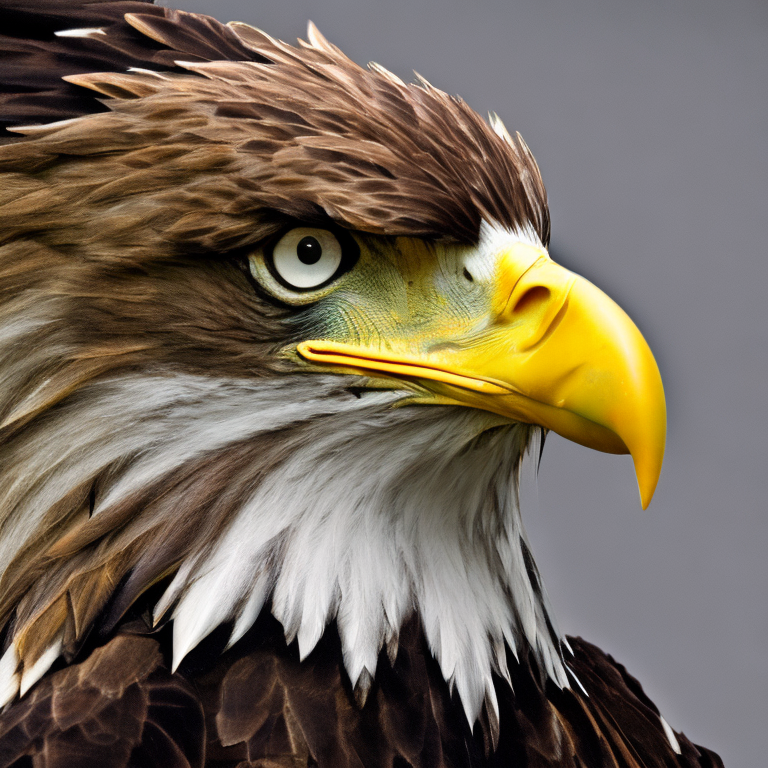

In [5]:

gen_sd_img(prompt = 'An eagle',
           seed = 0)

In [6]:
a =  gen_sd_img(prompt = 'An eagle',
           seed = 0)
type(a)

  0%|          | 0/45 [00:00<?, ?it/s]

PIL.Image.Image

In [7]:
type(a)

PIL.Image.Image

## Prompting Stable Diffusion
In this section we will practice how to generate high quality, specific, and relevant images using Stable Diffusion prompting techniques.

You might be wondering why do we need to learn prompting?

Let's say we want to generate an image of  an eagle soaring majestically in the sky. A beginner might just write:

> 'An eagle'

Let's use our custom function and generate an image using this prompt.

  0%|          | 0/45 [00:00<?, ?it/s]

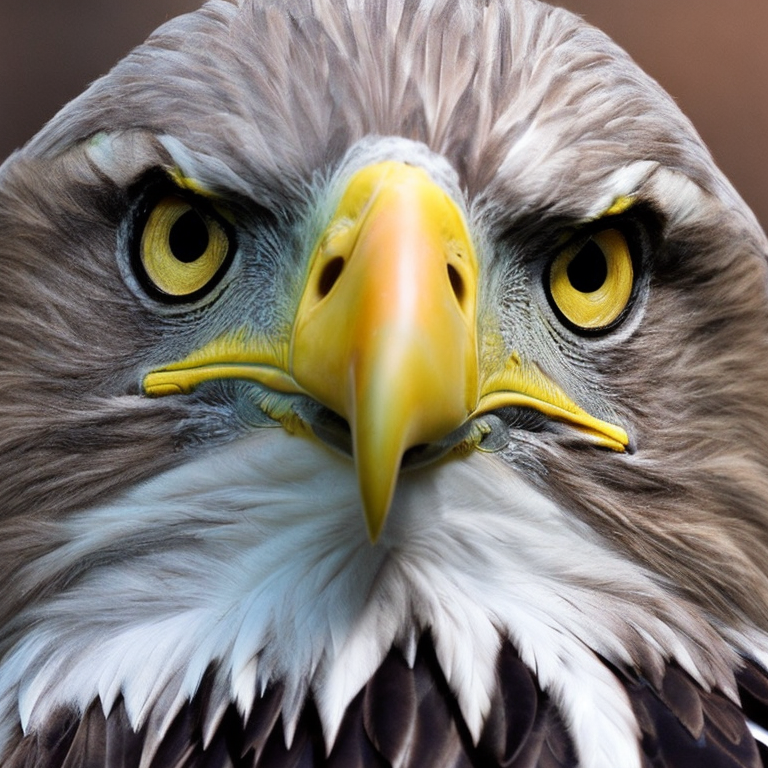

In [8]:
gen_sd_img(prompt = 'An eagle',
           seed = 358870059)

Let's improve our prompt and see if the result is better.

  0%|          | 0/45 [00:00<?, ?it/s]

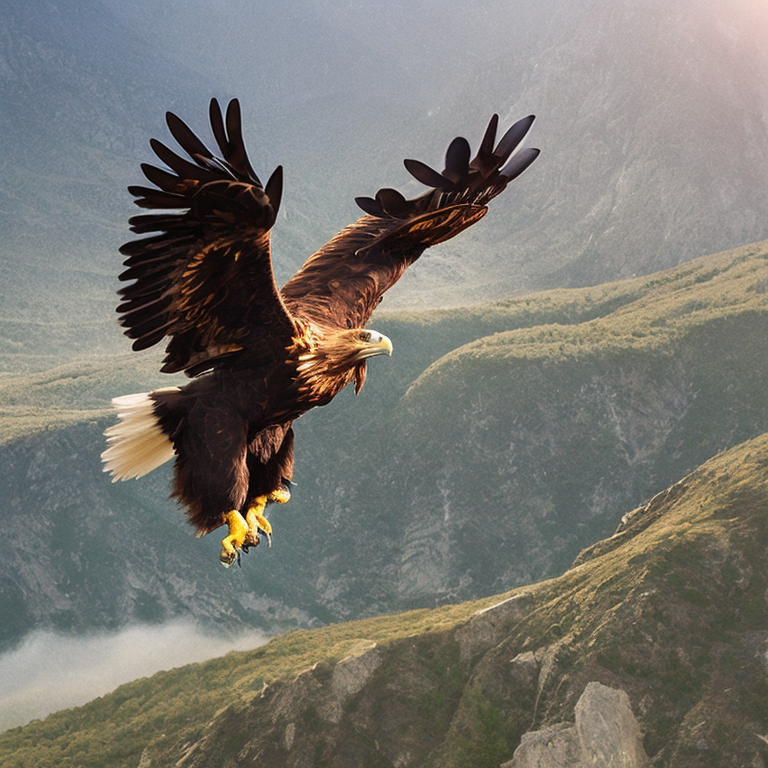

In [9]:
gen_sd_img(prompt = 'A majestic golden eagle soaring gracefully over a rugged mountain landscape, with its wings spread wide and sunlight gleaming off its feathers',
           seed = 358870059)

So, it is up to us to guide the model to generate an image we want. How do we do that? Well, there are some effective practices that we have to learn to create specific and precise prompts.
<br><br>

**How to create effective prompts?**
To craft an effective prompt, it's crucial to be detailed and specific. A good practice in prompting is to look for a list of keyword categories and select the ones that suits you needs.

Some categories:
* Subject
* Medium
* Style
* Artist
* Resolution
<br><br>

**Note:** You don't have to include all keywords from all categories.
<br><br>

The first category while writing a prompt is the ***subject***. Think of the subject as the heart of your image, what you truly want to see.

Let's say we want to generate an image of a cat sitting on a window sill.

  0%|          | 0/45 [00:00<?, ?it/s]

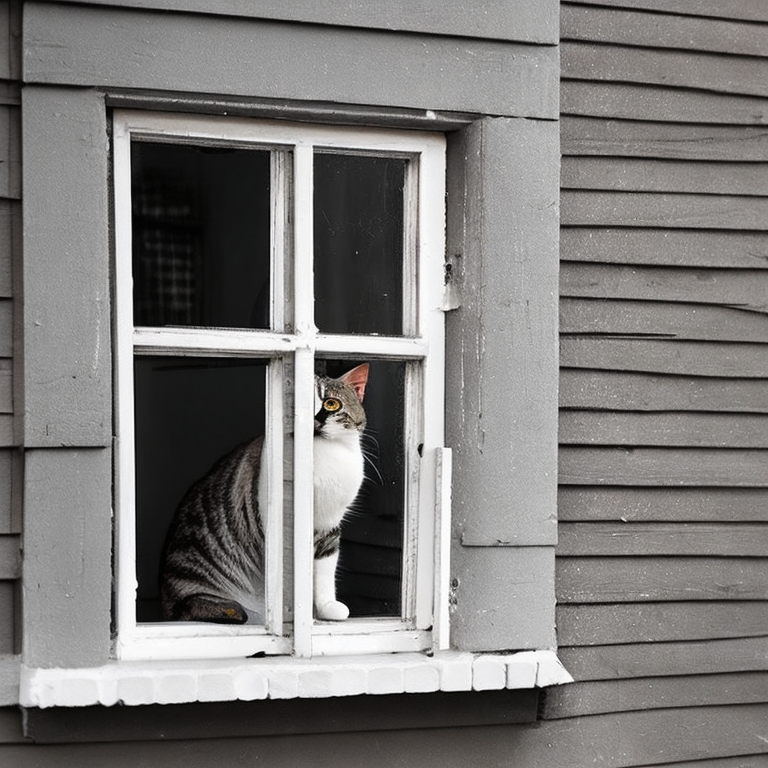

In [10]:
gen_sd_img(prompt = 'A cat sitting on a window sill',
           seed = 358870059)

  0%|          | 0/45 [00:00<?, ?it/s]

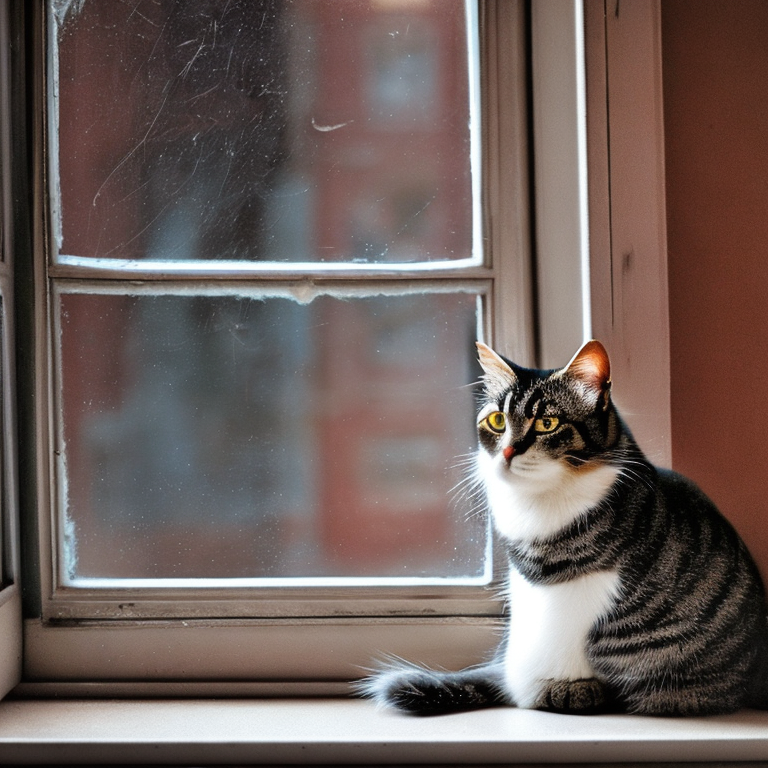

In [11]:
gen_sd_img(prompt = 'A cat sitting on a window sill',
           seed = 12345678)

Without specifying a ***medium***, the model is free to interpret the prompt using various artistic techniques. The result could be a digital painting, an oil portrait, a charcoal sketch, or any other medium depending on the model's training data and inherent creative choice
<br><br>

Next, let's add a keyword from the *medium* category.

  0%|          | 0/45 [00:00<?, ?it/s]

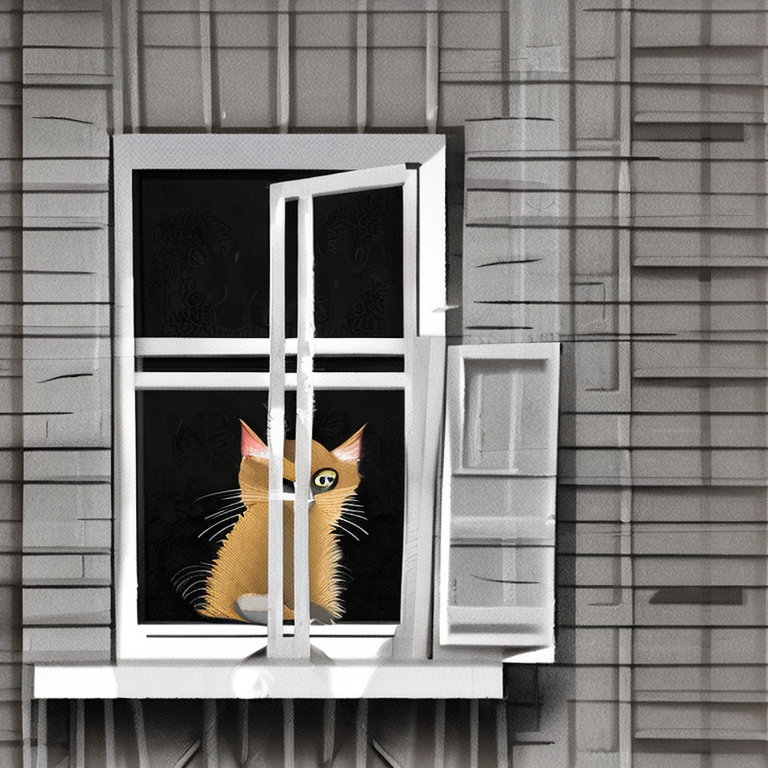

In [12]:
gen_sd_img(prompt = 'A digital illustration of a cat sitting on a window still',
           seed = 358870059)

In this prompt, by mentioning *digital illustration* as the medium, the AI is directed to create the artwork using digital tools and techniques. The resulting image is likely to have clean lines, vibrant colors, and digital effects that are characteristic of digital illustrations.
<br><br>

Let's look at some more examples.

  0%|          | 0/45 [00:00<?, ?it/s]

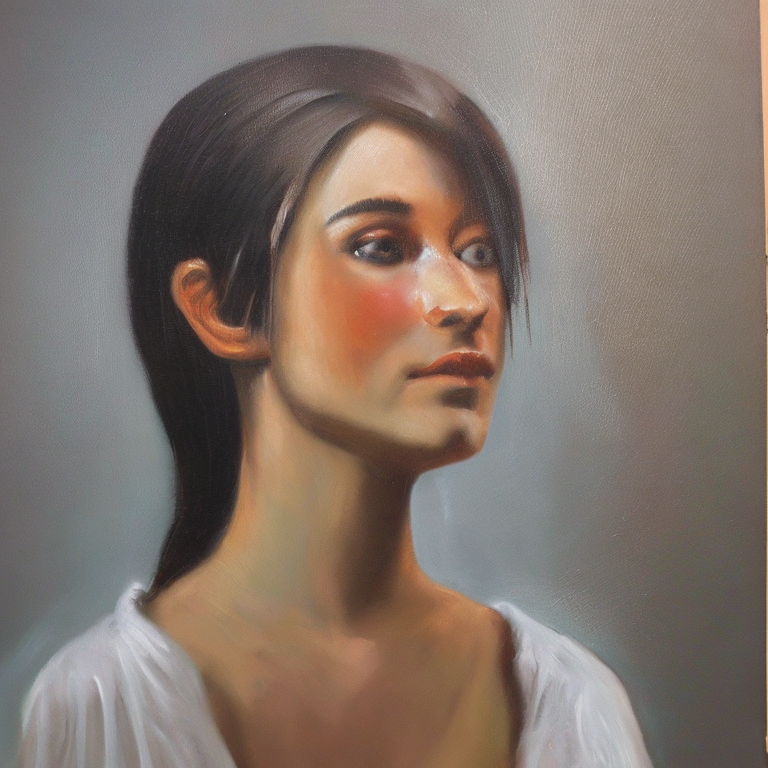

In [13]:
gen_sd_img(prompt = 'A woman, oil painting',
           seed = 358870059)

  0%|          | 0/45 [00:00<?, ?it/s]

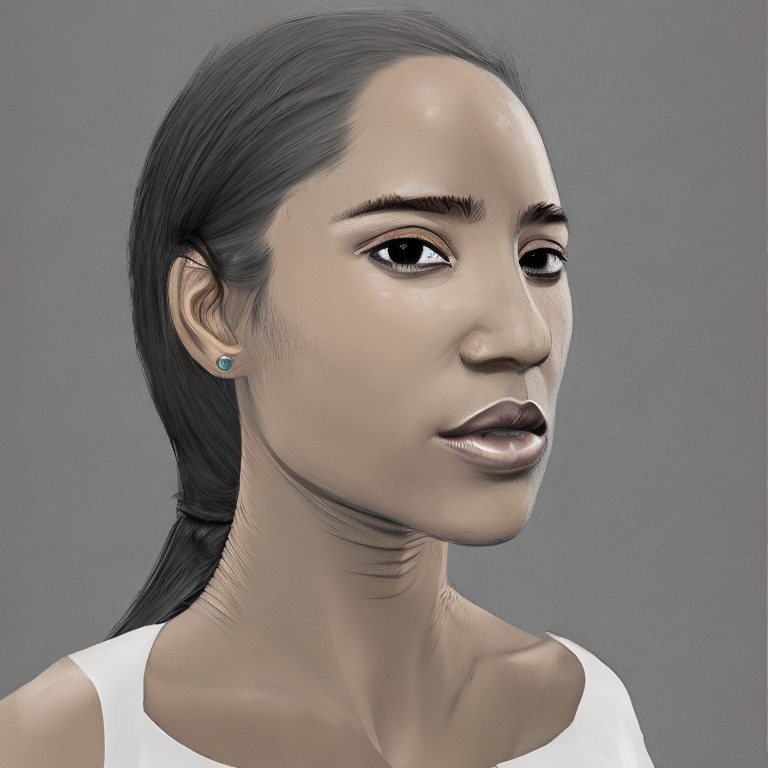

In [15]:
gen_sd_img(prompt = 'A digital portrait of a woman',
           seed = 358870059)

By specifying the term *digital portrait*, the AI is guided to create the artwork digitally. The result is more likely to have the characteristics typical of digital artwork, such as sharp lines, precise detailing, and so on.

We can further improve our prompt  by adding a ***style*** to it. Style is the unique aesthetic and visual qualities of the generated images. It's like an artist's signature brushstroke or a photographer's distinctive framing. It gives the artwork its personality.
<br><br>

A style can be hyperrealistic, full body, fantasy, surrealist, and so on.

  0%|          | 0/45 [00:00<?, ?it/s]

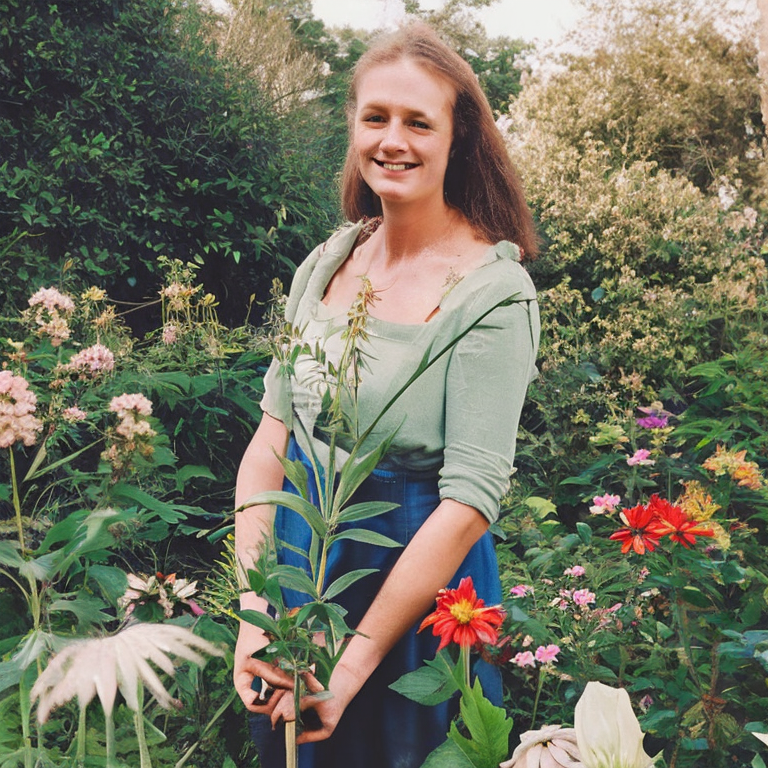

In [17]:
gen_sd_img(prompt = 'A woman standing in a garden holding a flower',
           seed = 358870059)

  0%|          | 0/45 [00:00<?, ?it/s]

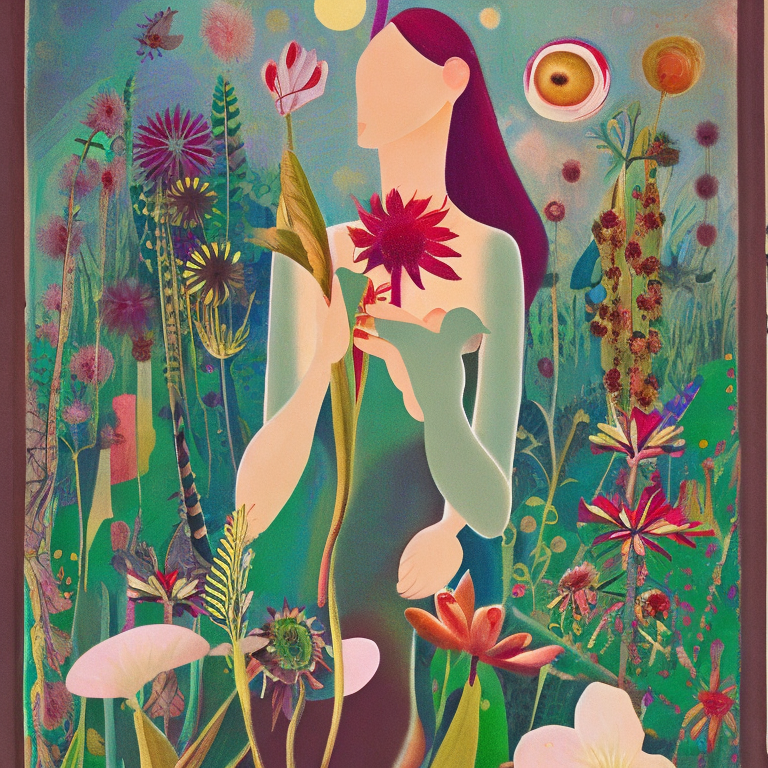

In [20]:
gen_sd_img(prompt = 'A woman standing in a garden holding a flower, in a surrealist style',
           seed = 358870059)

Using ***artist*** names in our prompt is another technique that will help the model to generate the image based on something that is common rather than guessing what we need.

  0%|          | 0/45 [00:00<?, ?it/s]

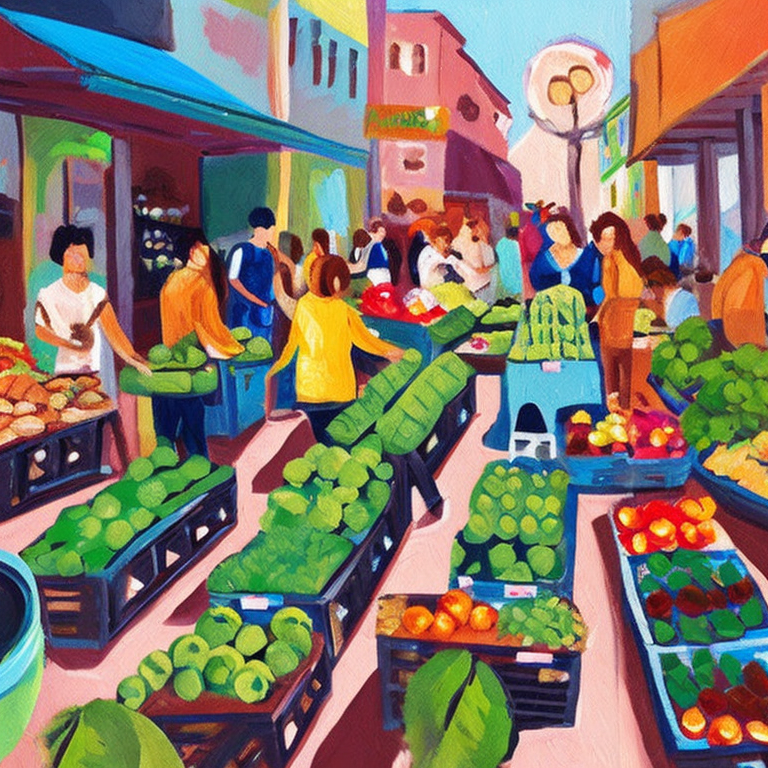

In [23]:
gen_sd_img(prompt = 'Paint a vibrant market scene with fruits, vegetables, and people',
           seed = 358870059)

In this prompt without specifying a particular artist, the AI is given general instructions to create a market scene with colorful elements. The result may vary widely and lack a specific artistic influence.

  0%|          | 0/45 [00:00<?, ?it/s]

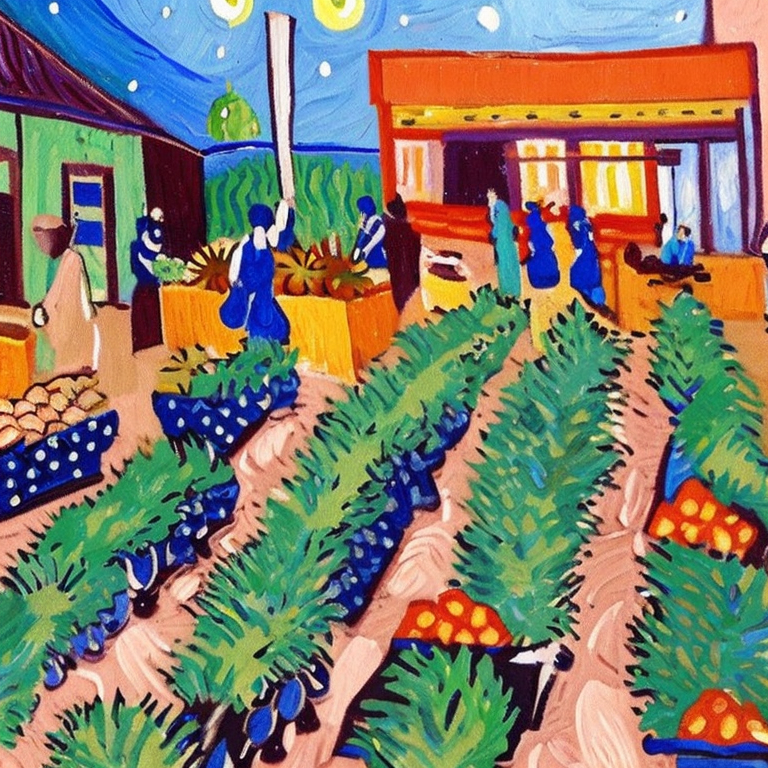

In [24]:
gen_sd_img(prompt = 'Paint a vibrant market scene with fruits, vegetables, and people in the style of Vincent van Gogh',
           seed = 358870059)

By referencing ***Van Gogh***, the prompt guides the AI to emulate the unique style of the renowned artist. This could result in bold, expressive brushstrokes, vibrant colors, and dynamic compositions characteristic of Van Gogh's work.
<br><br>

Let's look at some more examples

  0%|          | 0/45 [00:00<?, ?it/s]

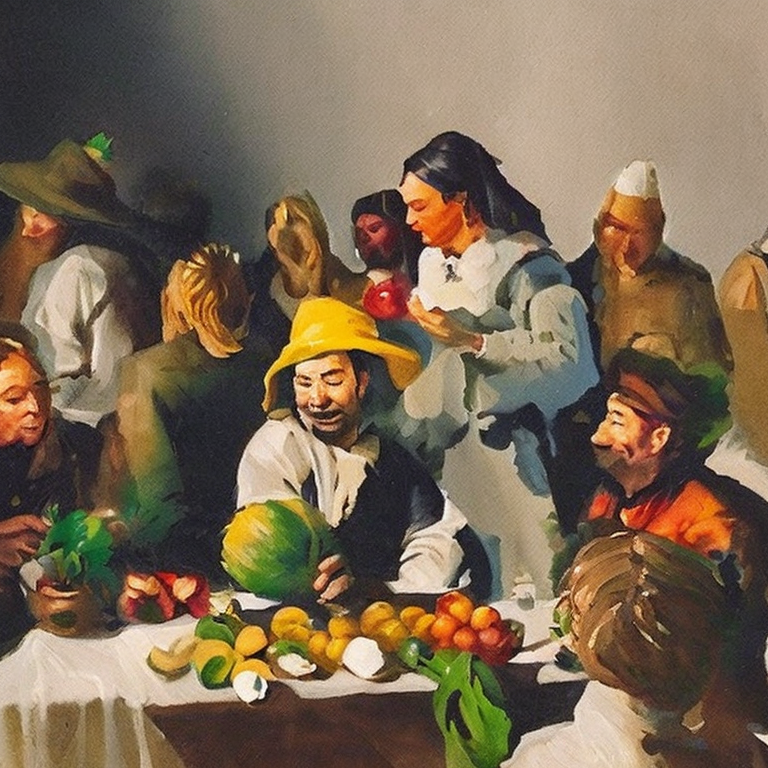

In [25]:
gen_sd_img(prompt = 'Paint a vibrant market scene with fruits, vegetables, and people in the style of Rembrandt van Rijn',
           seed = 358870059)

  0%|          | 0/45 [00:00<?, ?it/s]

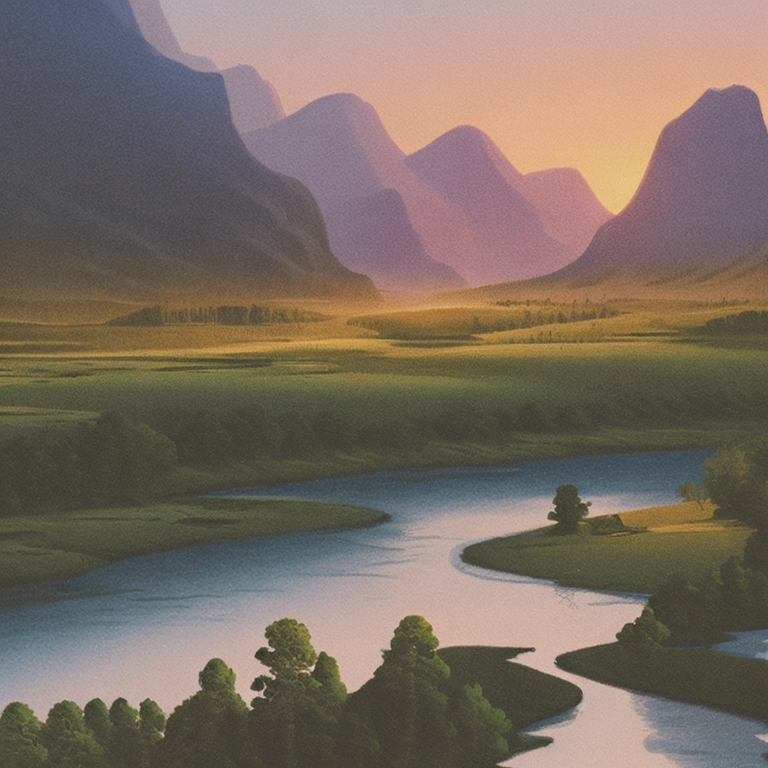

In [26]:
gen_sd_img(prompt = 'A serene landscape with mountains, a river, and a sunset',
           seed = 358870059)

The above result could be influenced by various landscape artists, leading to a more generalized representation. Now, we add the artist name.


  0%|          | 0/45 [00:00<?, ?it/s]

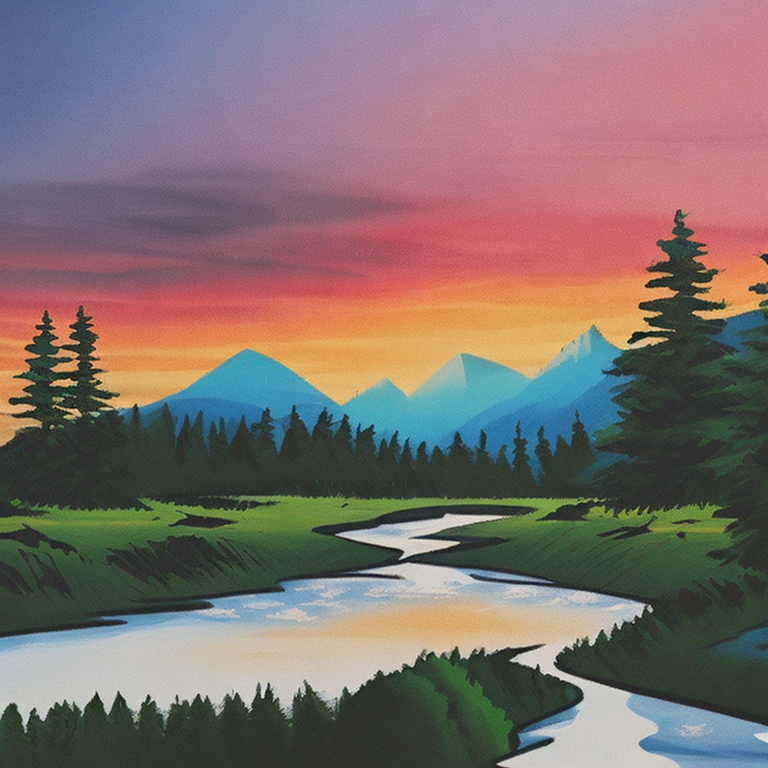

In [27]:
gen_sd_img(prompt = 'A serene landscape reminiscent of a Bob Ross painting, featuring mountains, a river, and a sunset',
           seed = 358870059)

In this prompt, by mentioning ***Bob Ross***, the AI is directed to emulate the iconic style of the renowned landscape artist. This guidance might result in specific elements such as fluffy clouds, distinctive foliage, and a particular color palette reminiscent of Bob Ross's work.
<br><br>

By including the artist's name, we can steer the AI's creativity in a particular artistic direction, ensuring the generated artwork reflects the nuances and characteristics of that artist's style.
<br><br>

We can alter the ***resolution*** of the output image by adding keywords such as *highly detailed*, *high resolution*, *sharp focus*, and so on.

Let's see an example.

  0%|          | 0/45 [00:00<?, ?it/s]

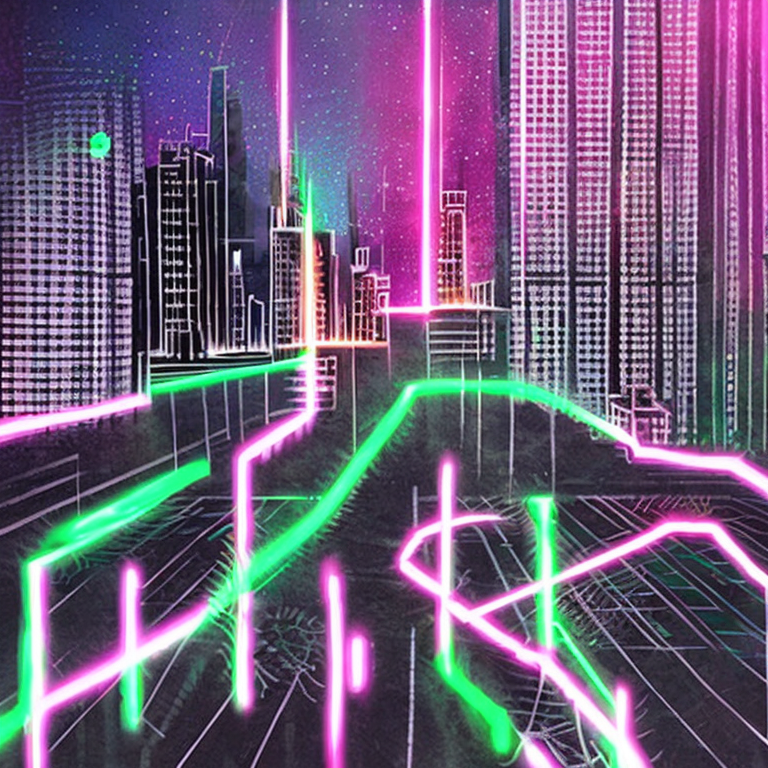

In [28]:
gen_sd_img(prompt = 'Create a digital artwork of a city skyline at night with neon lights',
           seed = 358870059)

In this prompt, without specifying the resolution, the AI will generate the image at a default resolution, which might vary depending on the platform or settings. The output could be of standard quality and size, suitable for general viewing but not necessarily optimized for specific uses like printing or high-quality digital displays.

  0%|          | 0/45 [00:00<?, ?it/s]

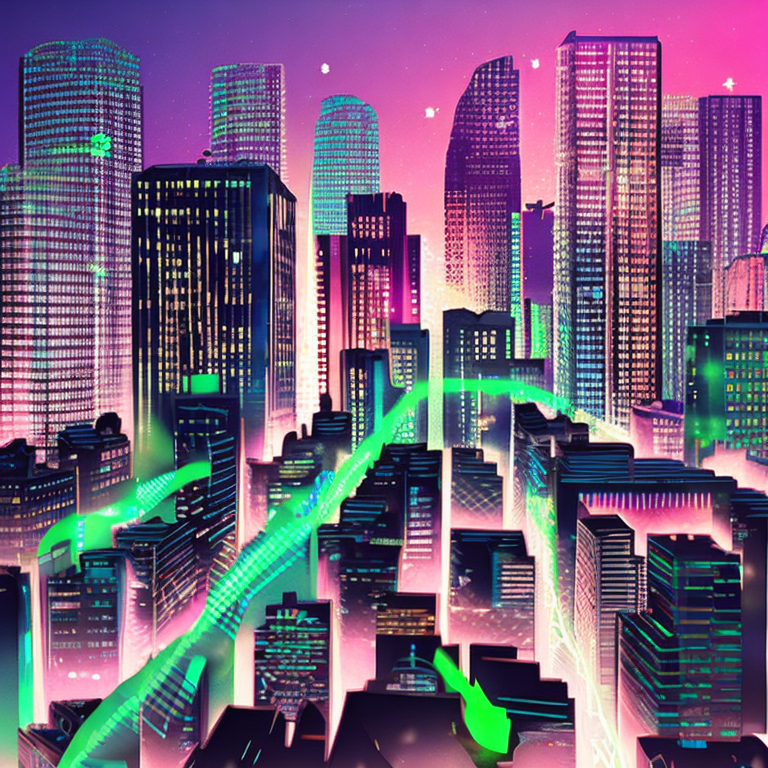

In [29]:
gen_sd_img(prompt = 'Create a high-resolution digital artwork (at least 6000x4000 pixels) of a city skyline at night with neon lights',
           seed = 358870059)

In this prompt, by specifying the resolution (6000x4000 pixels), the AI is guided to generate a high-quality, detailed image suitable for printing or large digital displays. The output will have a higher pixel density, ensuring sharpness and clarity even in larger formats.
<br><br>
Finally, let's add some additional details to modify the output images further.

  0%|          | 0/45 [00:00<?, ?it/s]

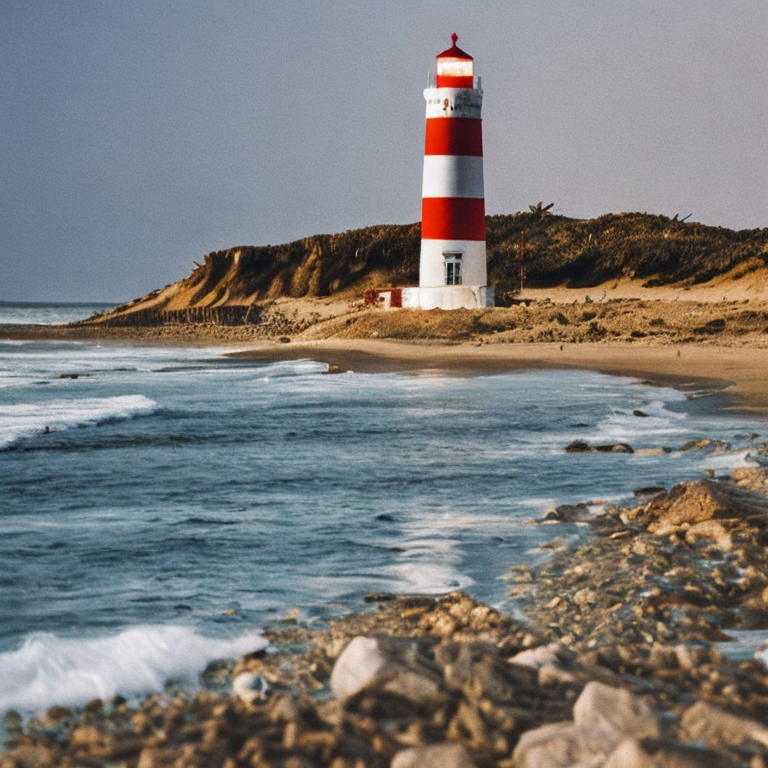

In [30]:
gen_sd_img(prompt = 'A beach with a lighthouse',
           seed = 358870059)

In this prompt, the AI has minimal information to work with. It may generate a basic beach scene with a lighthouse, but the lack of specific details leaves room for creative interpretation. The resulting image could vary widely in terms of style, mood, and level of detail.

  0%|          | 0/45 [00:00<?, ?it/s]

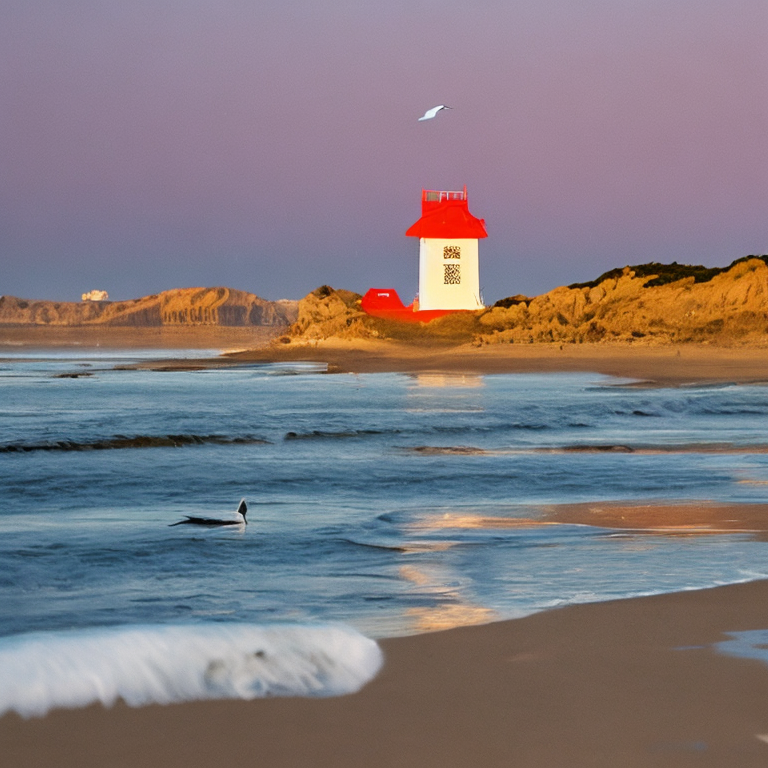

In [ ]:
gen_sd_img(prompt = 'A serene beach at sunrise with a weathered, red-and-white striped lighthouse, golden morning light, seagulls gracefully circling above the calm, azure waters',
           seed = 358870059)

In this prompt, the inclusion of specific additional details paints a vivid picture. The AI is guided to create a scene with distinct elements: the sunrise setting, the lighthouse's appearance, the behavior of seagulls, and the presence of a couple on the beach. The result is more likely to align with the serene, romantic, and picturesque scene described.
<br><br>

To summarize:
* Prompting in Stable Diffusion involves providing specific textual descriptions to guide the AI in generating images.
* A good prompt includes detailed information about the subject, medium, style, artist, resolution, color, lighting, and other relevant elements.
* Specificity is crucial; vague prompts lead to varied interpretations.
* We can enhance prompts by including artist names, guiding the AI to emulate particular styles.
* Techniques like keyword weighting, syntax usage, and negative prompts refine outcomes.
* Experimentation, clarity, and understanding of the AI's capabilities are key to effective prompting in Stable Diffusion.

## Negative Prompting
Using negative prompts is another great way to steer the image, but instead of putting in what you want, you put in what you don't want.

They don't need to be objects. They can also be styles and unwanted attributes. (e.g. ugly, deformed)

Let's consider a new image.

  0%|          | 0/45 [00:00<?, ?it/s]

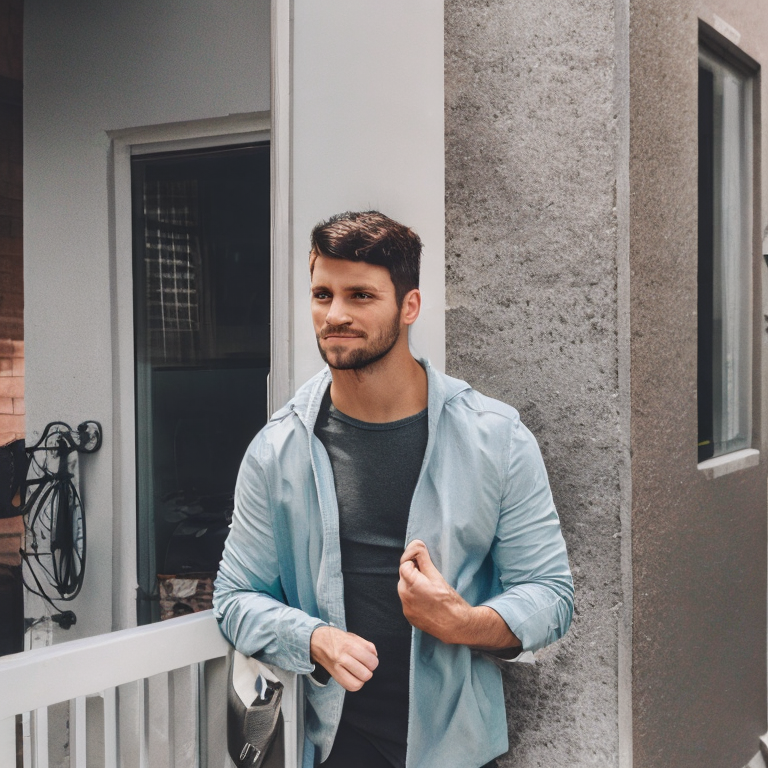

In [31]:
gen_sd_img(prompt = 'A man waking in neighbourhood, with good outfit, perfect face',
           seed = 358870059)

If you notice in the above image generated, We can see that there are irregular looking features of the subject such as the hands. Hence, we can add a negative prompt to fix the image and get the desired output.

  0%|          | 0/45 [00:00<?, ?it/s]

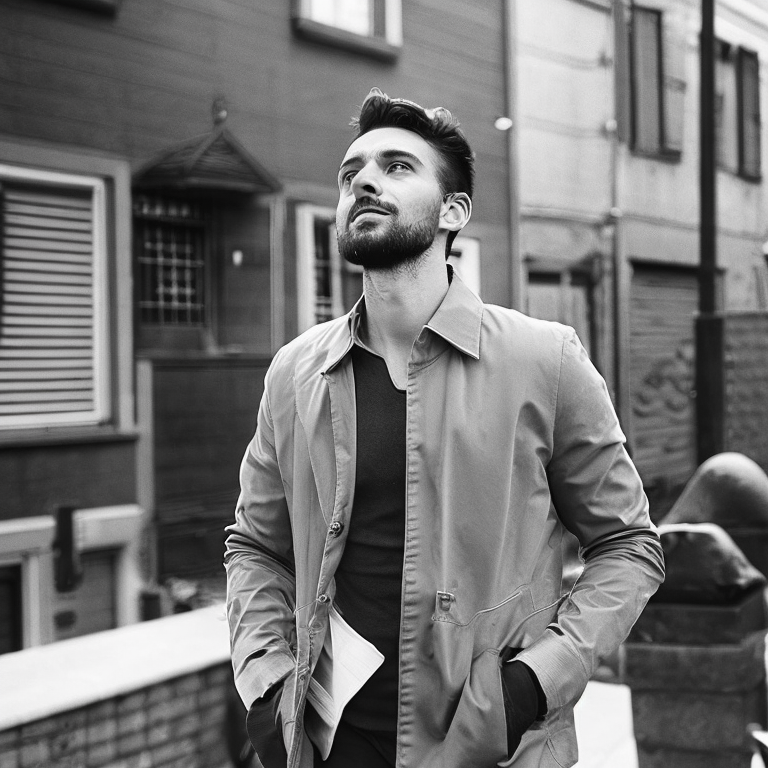

In [32]:
gen_sd_img(prompt = 'A man waking in neighbourhood, with good outfit, perfect face, detailed facial features',
           negative_prompt = "ugly, poorly drawn hands, poorly drawn face",
           seed = 358870059)

You can see that this time, the model has produced a much better and more relevant image. This is the importance of negative prompting in Stable Diffusion.
<br><br>

Let's look at another example.

  0%|          | 0/45 [00:00<?, ?it/s]

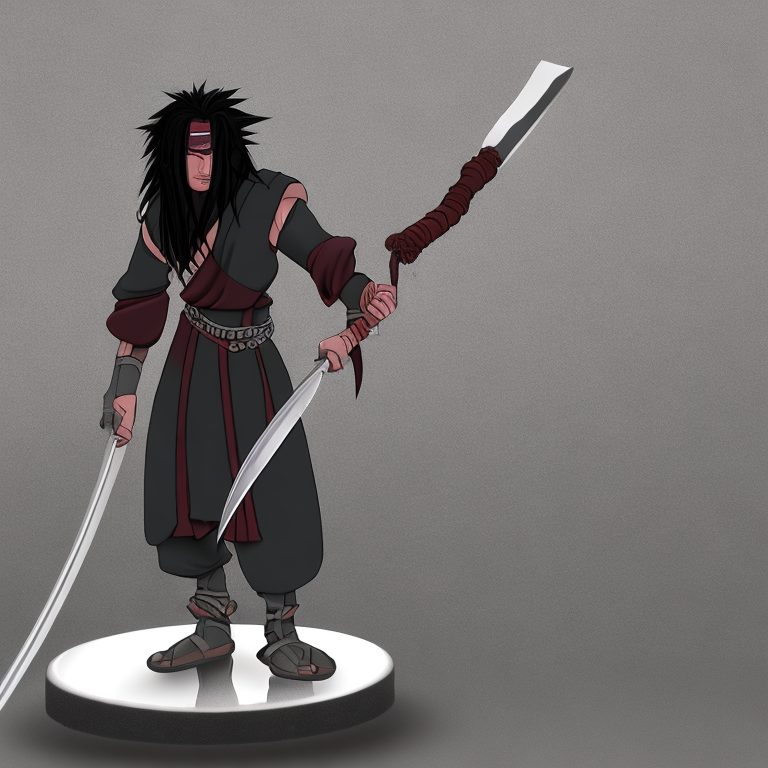

In [33]:
gen_sd_img(prompt = 'Madara in battleground, holding a sword, detailed face, cinematic',
           seed = 358870059)

  0%|          | 0/45 [00:00<?, ?it/s]

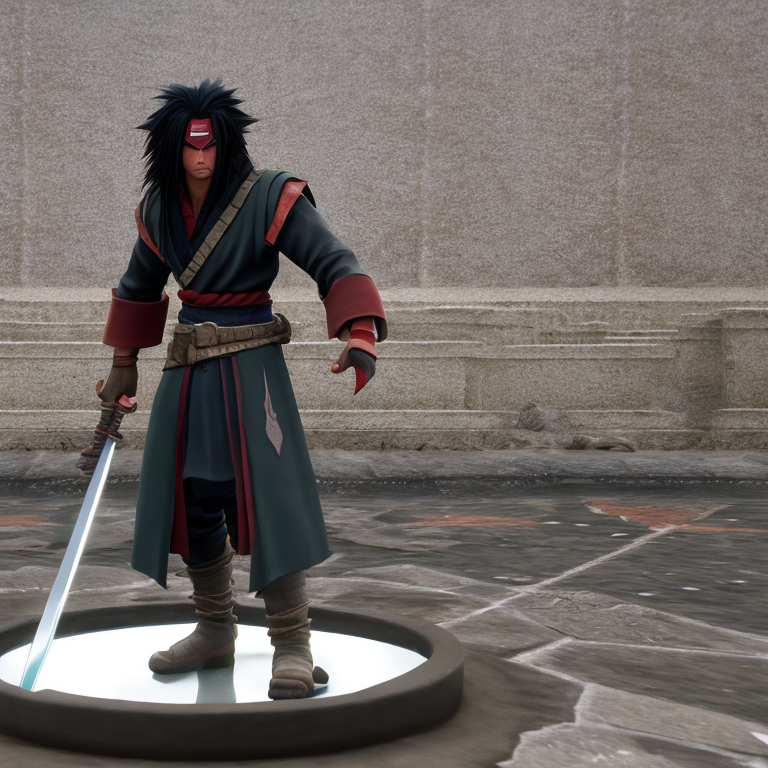

In [34]:
gen_sd_img(prompt = 'Madara in battleground, holding a sword, detailed face, cinematic',
           negative_prompt = 'ugly, weird faces, poorly drawn hands, poorly drawn legs, out of frame',
           seed = 358870059)

Again the model has perfected the issues that occured in the initial generation of the image without a negative prompt. Therefore, it is crucial to provide a negative prompt in order to generate images and fine-tune them into our desired output.
<br><br>

The following is a decent boilerplate negative prompt without affecting styles

> ***ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, cut off, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face***
<br><br>

Let us utilize the above negative prompt in one of the above generated images.

  0%|          | 0/45 [00:00<?, ?it/s]

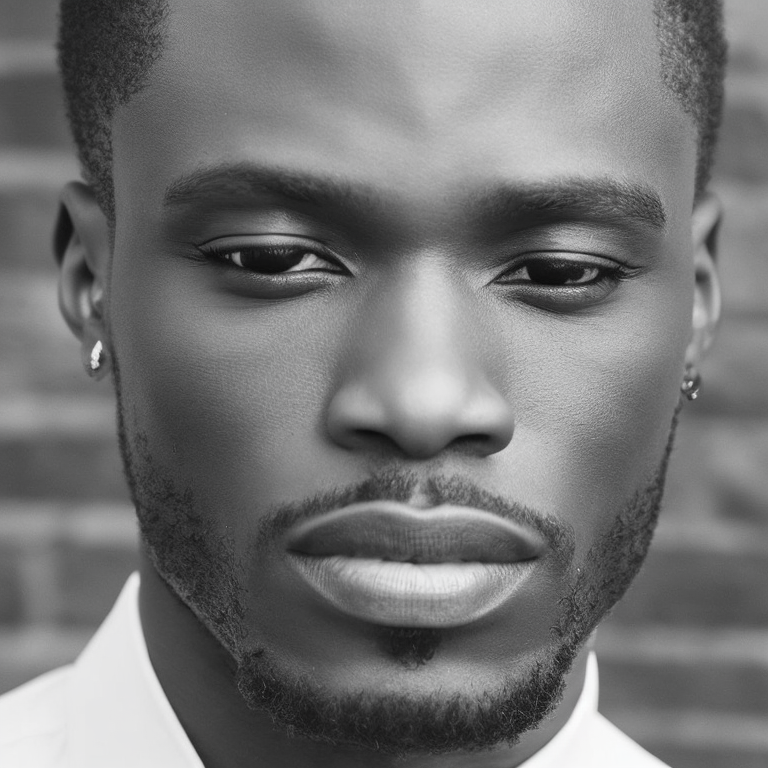

In [35]:
gen_sd_img(prompt = 'A man, perfect face with good outfit, detailed facial features',
           negative_prompt = 'ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face',
           seed = 358870059)

## Keyword Weight
Keyword weight in diffusion model prompting refers to the importance or significance assigned to specific keywords or phrases used in a prompt when generating an image using a diffusion model.

The model assigns different degrees of importance to different parts of the prompt. This can affect the visual features, style, and content of the generated image. For example, if you want the image to focus on a specific object or concept, you might give more weight to keywords associated with that object in your prompt.

You can adjust the weight of a keyword by the syntax **(keyword: factor)**. factor is a value such that less than **1** means less important and larger than **1** means more important.
<br><br>


Let's see the following example.

  0%|          | 0/45 [00:00<?, ?it/s]

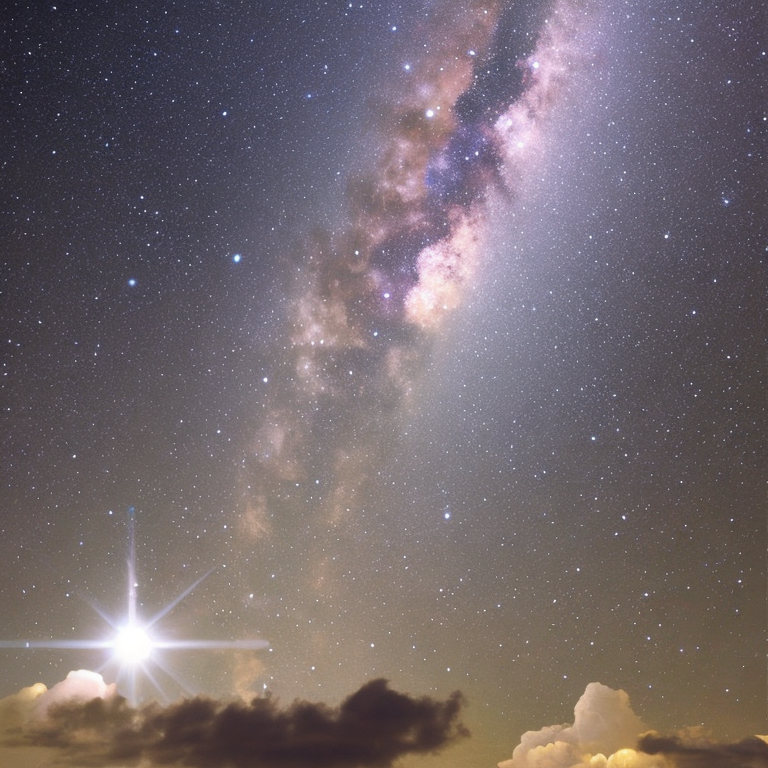

In [36]:
gen_sd_img(prompt = 'realistic photo of night sky with (clouds:1 and stars:1)',
           negative_prompt = 'birds, aircraft, tree branches',
           seed = 358870059)

  0%|          | 0/45 [00:00<?, ?it/s]

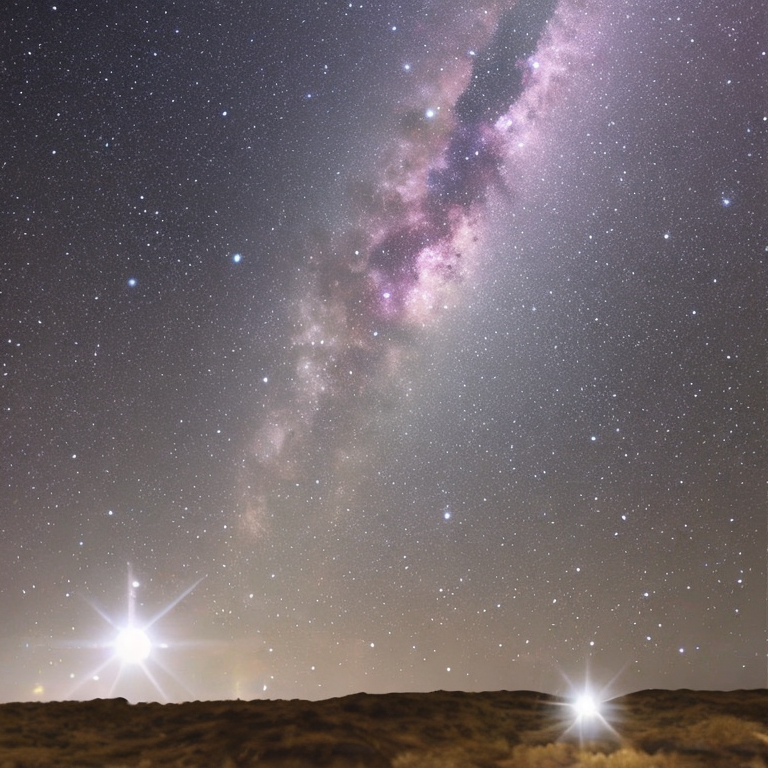

In [37]:
gen_sd_img(prompt = 'realistic photo of night sky with (clouds:0.5 and stars:10)',
           negative_prompt = 'birds, aircraft, tree branches',
           seed = 358870059)

In summary, negative prompts and keyword weight provide essential tools for guiding diffusion models, enabling users to establish boundaries, enforce ethical guidelines, and fine-tune output to meet specific requirements while ensuring responsible use.